In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Reading csv files of Sales and Ingredients

df_sales = pd.read_csv('Pizza_Sale.csv')
df_ingredients = pd.read_csv('Pizza_Ingredients.csv')

In [3]:
df_sales.sample(5)

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_category,pizza_ingredients,pizza_name
9281,9282,4064,veggie_veg_m,1,10/3/2015,12:39:50,16.00,16.00,M,Veggie,"Mushrooms, Tomatoes, Red Peppers, Green Pepper...",The Vegetables + Vegetables Pizza
45577,45578,20012,ital_supr_m,1,6/12/2015,18:34:20,16.50,16.50,M,Supreme,"Calabrese Salami, Capocollo, Tomatoes, Red Oni...",The Italian Supreme Pizza
475,476,203,cali_ckn_l,1,4/1/2015,11:30:48,20.75,20.75,L,Chicken,"Chicken, Artichoke, Spinach, Garlic, Jalapeno ...",The California Chicken Pizza
16546,16547,7286,pepperoni_l,1,2/5/2015,18:42:09,15.25,15.25,L,Classic,"Mozzarella Cheese, Pepperoni",The Pepperoni Pizza
4381,4382,1951,spicy_ital_l,1,2/2/2015,13:39:08,20.75,20.75,L,Supreme,"Capocollo, Tomatoes, Goat Cheese, Artichokes, ...",The Spicy Italian Pizza


In [4]:
df_ingredients.head()

,pizza_name_id,pizza_name,pizza_ingredients,Items_Qty_In_Grams
0,bbq_ckn_l,The Barbecue Chicken Pizza,Barbecued Chicken,40.0
1,bbq_ckn_l,The Barbecue Chicken Pizza,Red Peppers,15.0
2,bbq_ckn_l,The Barbecue Chicken Pizza,Green Peppers,20.0
3,bbq_ckn_l,The Barbecue Chicken Pizza,Tomatoes,30.0
4,bbq_ckn_l,The Barbecue Chicken Pizza,Red Onions,60.0


In [5]:
# PREPROCESSING

In [6]:
# Checking for Duplicated rows

df_sales.duplicated().sum()

0

In [7]:
# Checking for Missing Values

df_sales.isna().sum()

pizza_id              0
order_id              0
pizza_name_id        16
quantity              0
order_date            0
order_time            0
unit_price            0
total_price           7
pizza_size            0
pizza_category       23
pizza_ingredients    13
pizza_name            7
dtype: int64

In [8]:
# Imputing Missing Values

In [9]:
# Creating 'pizza_name_id' mapping for imputing missing values

name_id_mapping = (
    df_sales[df_sales['pizza_name_id'].notnull()]
    .drop_duplicates(subset=['pizza_name', 'pizza_size'])
    .set_index(['pizza_name', 'pizza_size'])['pizza_name_id']
    .to_dict()
)

In [10]:
# Imputing missing values of 'pizza_name_id' column

def fill_pizza_name_id(row):
    if pd.isnull(row['pizza_name_id']):
        return name_id_mapping.get((row['pizza_name'], row['pizza_size']))
    return row['pizza_name_id']

df_sales['pizza_name_id'] = df_sales.apply(fill_pizza_name_id, axis=1)

In [11]:
# Imputing missing values of 'total_price' column by multiplying 'quantity' and 'unit_price columns'

df_sales['total_price'] = df_sales['total_price'].fillna(df_sales['quantity'] * df_sales['unit_price'])

In [12]:
# Creating mapping and imputing missing values for 'pizza_name' column

name_mapping = (
    df_sales[df_sales['pizza_name'].notnull()]
    .drop_duplicates(subset='pizza_name_id')
    .set_index('pizza_name_id')['pizza_name']
)

df_sales['pizza_name'] = df_sales['pizza_name'].fillna(df_sales['pizza_name_id'].map(name_mapping))

In [13]:
# Creating mapping and imputing missing values for 'pizza_ingredients' column

ingredients_mapping = (
    df_sales[df_sales['pizza_ingredients'].notnull()]
    .drop_duplicates(subset='pizza_name')
    .set_index('pizza_name')['pizza_ingredients']
    .to_dict()
)

df_sales['pizza_ingredients'] = df_sales['pizza_ingredients'].fillna(df_sales['pizza_name'].map(ingredients_mapping))

In [14]:
# 'pizza_category' column is not useful for analysis and forecasting. So, the column will be dropped.

df_sales = df_sales.drop(columns=['pizza_category'])

In [15]:
# Checking for any missing values left

df_sales.isna().sum()

pizza_id             0
order_id             0
pizza_name_id        0
quantity             0
order_date           0
order_time           0
unit_price           0
total_price          0
pizza_size           0
pizza_ingredients    0
pizza_name           0
dtype: int64

In [16]:
# Correcting Datatypes

In [17]:
# checking for Datatypes

df_sales.dtypes

pizza_id               int64
order_id               int64
pizza_name_id         object
quantity               int64
order_date            object
order_time            object
unit_price           float64
total_price          float64
pizza_size            object
pizza_ingredients     object
pizza_name            object
dtype: object

In [18]:
# Converting 'order_date' and 'order_time' column Datatype to 'datetime'.

df_sales['order_date'] = pd.to_datetime(df_sales['order_date'], dayfirst=True, format='mixed')
df_sales['order_time'] = pd.to_datetime(df_sales['order_time']).dt.time

C:\Users\HP\AppData\Local\Temp\ipykernel_12844\1761053767.py:4: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_sales['order_time'] = pd.to_datetime(df_sales['order_time']).dt.time


In [19]:
# Combining date and time for 'order_time' column
from datetime import datetime

df_sales['order_time'] = df_sales.apply(lambda row: datetime.combine(row['order_date'], row['order_time']), axis=1)

In [20]:
# Coverting 'pizza_name_id' column values to lower for uniformity

df_sales['pizza_name_id'] = df_sales['pizza_name_id'].str.strip().str.lower()

In [21]:
df_sales.head()

,pizza_id,order_id,pizza_name_id,quantity,order_date,order_time,unit_price,total_price,pizza_size,pizza_ingredients,pizza_name
0,1,1,hawaiian_m,1,2015-01-01,2015-01-01 11:38:36,13.25,13.25,M,"Sliced Ham, Pineapple, Mozzarella Cheese",The Hawaiian Pizza
1,2,2,classic_dlx_m,1,2015-01-01,2015-01-01 11:57:40,16.00,16.00,M,"Pepperoni, Mushrooms, Red Onions, Red Peppers,...",The Classic Deluxe Pizza
2,3,2,five_cheese_l,1,2015-01-01,2015-01-01 11:57:40,18.50,18.50,L,"Mozzarella Cheese, Provolone Cheese, Smoked Go...",The Five Cheese Pizza
3,4,2,ital_supr_l,1,2015-01-01,2015-01-01 11:57:40,20.75,20.75,L,"Calabrese Salami, Capocollo, Tomatoes, Red Oni...",The Italian Supreme Pizza
4,5,2,mexicana_m,1,2015-01-01,2015-01-01 11:57:40,16.00,16.00,M,"Tomatoes, Red Peppers, Jalapeno Peppers, Red O...",The Mexicana Pizza


In [22]:
# df_sales.to_csv('Pizza_Sale_Processed.csv')

In [23]:
# EXPLORATORY DATA ANALYSIS

In [24]:
# Knowing the statistics of pizza sales

df_sales.groupby('pizza_name_id')['quantity'].describe()[75:]

,count,mean,std,min,25%,50%,75%,max
pizza_name_id,,,,,,,,
spinach_fet_m,558.0,1.007168,0.084438,1.0,1.0,1.0,1.0,2.0
spinach_fet_s,437.0,1.004577,0.067573,1.0,1.0,1.0,1.0,2.0
spinach_supr_l,280.0,1.010714,0.103138,1.0,1.0,1.0,1.0,2.0
spinach_supr_m,266.0,1.003759,0.061314,1.0,1.0,1.0,1.0,2.0
spinach_supr_s,394.0,1.015228,0.122616,1.0,1.0,1.0,1.0,2.0
thai_ckn_l,1365.0,1.032967,0.182674,1.0,1.0,1.0,1.0,3.0
thai_ckn_m,474.0,1.014768,0.120750,1.0,1.0,1.0,1.0,2.0
thai_ckn_s,476.0,1.008403,0.091380,1.0,1.0,1.0,1.0,2.0
the_greek_l,255.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0


In [25]:
# Small sized pizzas ordered less compared to large sized pizza of same category
# 'big_meat_s' is highest ordered pizza and 'the_greek_xxl' is lowest ordered pizza

In [26]:
# Making a Dataframe with 'order_date', 'pizza_name_id' and 'quantity' columns that are useful for forecasting.
# Making 'order_date' column as index column

df = df_sales[['order_date', 'pizza_name_id', 'quantity']].set_index('order_date')
df.head()

,pizza_name_id,quantity
order_date,,
2015-01-01,hawaiian_m,1
2015-01-01,classic_dlx_m,1
2015-01-01,five_cheese_l,1
2015-01-01,ital_supr_l,1
2015-01-01,mexicana_m,1


In [27]:
# Making a Pivot table for better understanding

pivoted_df = df.pivot_table(index='order_date', columns='pizza_name_id', values='quantity', aggfunc='sum').fillna(0)
pivoted_df

pizza_name_id,bbq_ckn_l,bbq_ckn_m,bbq_ckn_s,big_meat_s,brie_carre_s,calabrese_l,calabrese_m,calabrese_s,cali_ckn_l,cali_ckn_m,...,thai_ckn_m,thai_ckn_s,the_greek_l,the_greek_m,the_greek_s,the_greek_xl,the_greek_xxl,veggie_veg_l,veggie_veg_m,veggie_veg_s
order_date,,,,,,,,,,,,,,,,,,,,,
2015-01-01,6.0,4.0,1.0,5.0,0.0,0.0,1.0,0.0,2.0,1.0,...,2.0,0.0,0.0,0.0,4.0,1.0,0.0,1.0,0.0,2.0
2015-01-02,3.0,4.0,2.0,8.0,0.0,0.0,0.0,0.0,3.0,2.0,...,2.0,3.0,0.0,4.0,2.0,1.0,0.0,4.0,1.0,0.0
2015-01-03,3.0,3.0,1.0,8.0,1.0,0.0,1.0,0.0,6.0,4.0,...,3.0,2.0,0.0,2.0,1.0,4.0,0.0,2.0,4.0,1.0
2015-01-04,6.0,4.0,1.0,0.0,2.0,0.0,1.0,1.0,3.0,1.0,...,2.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,1.0,0.0
2015-01-05,1.0,1.0,0.0,4.0,2.0,0.0,0.0,0.0,1.0,6.0,...,2.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-12-27,1.0,3.0,0.0,5.0,1.0,0.0,1.0,0.0,2.0,1.0,...,1.0,0.0,1.0,0.0,2.0,0.0,0.0,2.0,4.0,3.0
2015-12-28,0.0,1.0,1.0,3.0,1.0,0.0,1.0,0.0,2.0,1.0,...,1.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0
2015-12-29,1.0,3.0,0.0,6.0,1.0,2.0,0.0,0.0,1.0,4.0,...,1.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0


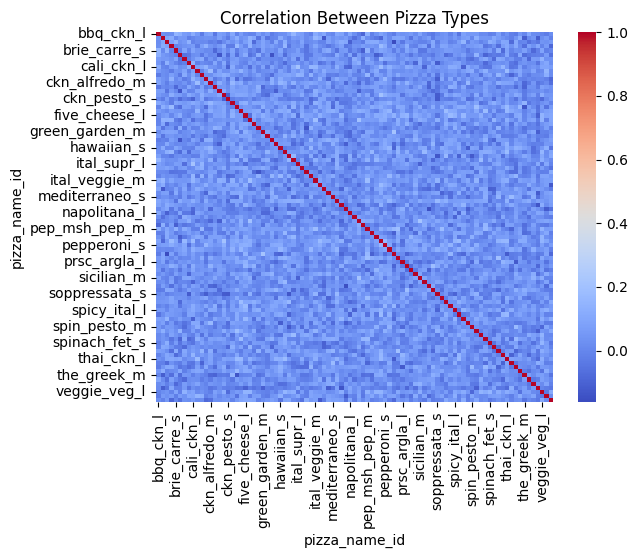

In [28]:
# Generating a Heatmap for showing correlation with other pizzas

correlation_matrix = pivoted_df.corr()
sns.heatmap(correlation_matrix, cmap='coolwarm')
plt.title("Correlation Between Pizza Types")
plt.show()

In [29]:
# Function for showing weekly sales of pizzas

def pizza_weekly_sales(pizza_name):
    df_pizza = df[df['pizza_name_id'] == pizza_name]
    df_pizza.resample('W')['quantity'].sum().plot(title=f'Weekly sales of {pizza_name}', figsize=(8, 2))
    plt.ylabel('Quantity Sold')
    plt.grid(True)
    plt.show()

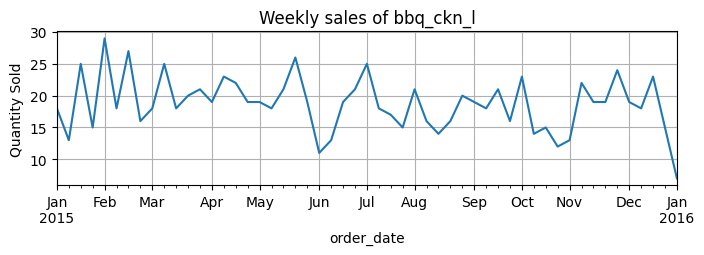

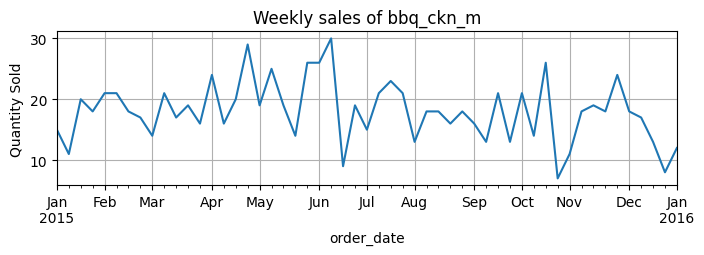

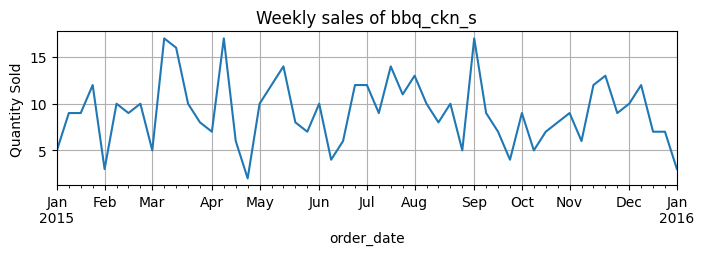

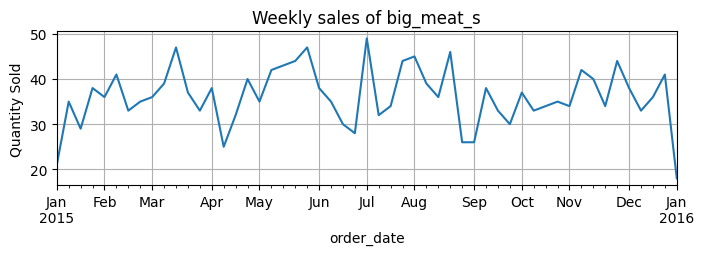

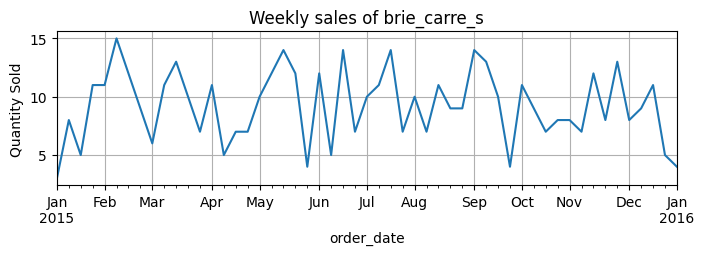

...

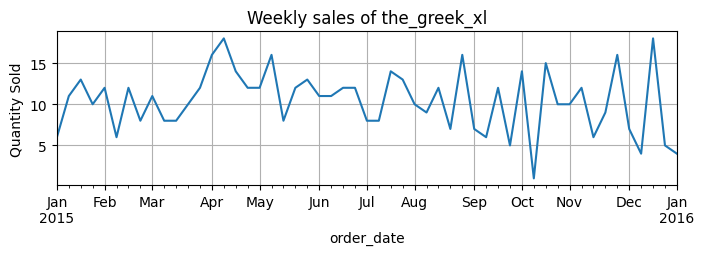

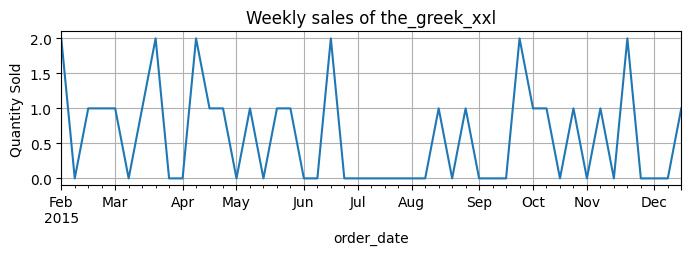

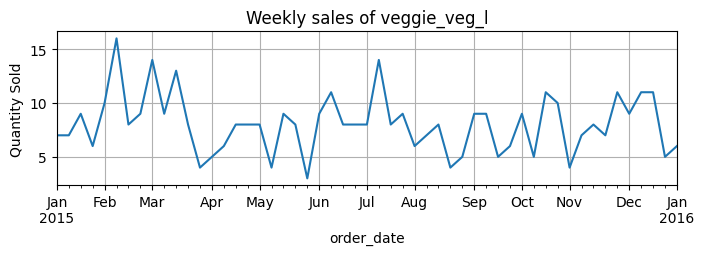

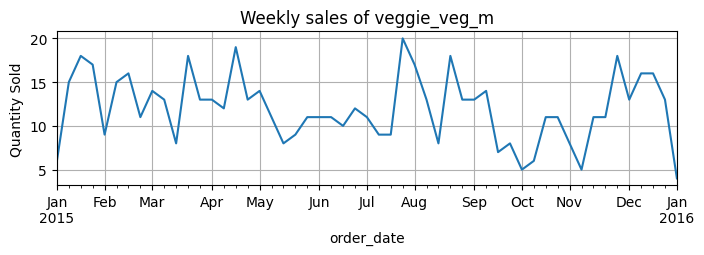

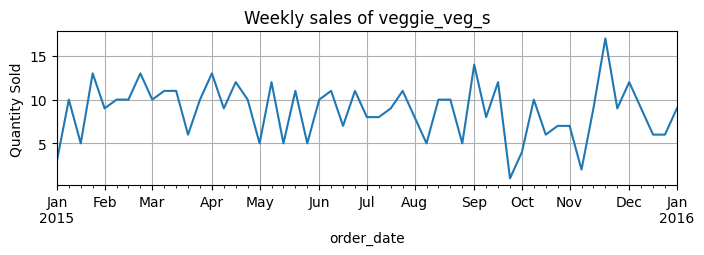

In [30]:
# Plotting sales of all pizzas with for loop

for pizza in pivoted_df.columns:
    pizza_weekly_sales(pizza)

In [31]:
# Top 10 most ordered pizzas 

top_10 = df.groupby('pizza_name_id')['quantity'].sum().reset_index().sort_values(by='quantity', ascending=False).head(10)
top_10

,pizza_name_id,quantity
3,big_meat_s,1914
80,thai_ckn_l,1410
20,five_cheese_l,1409
21,four_cheese_l,1316
18,classic_dlx_m,1181
68,spicy_ital_l,1109
28,hawaiian_s,1020
65,southw_ckn_l,1016
0,bbq_ckn_l,992
1,bbq_ckn_m,956


In [32]:
from statsmodels.tsa.seasonal import seasonal_decompose
import warnings
warnings.filterwarnings("ignore")

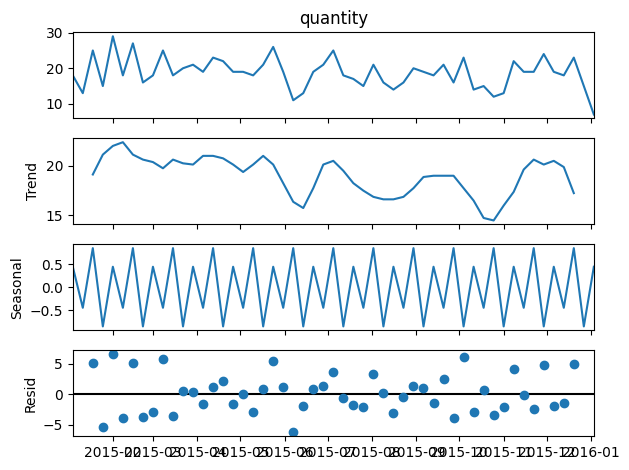

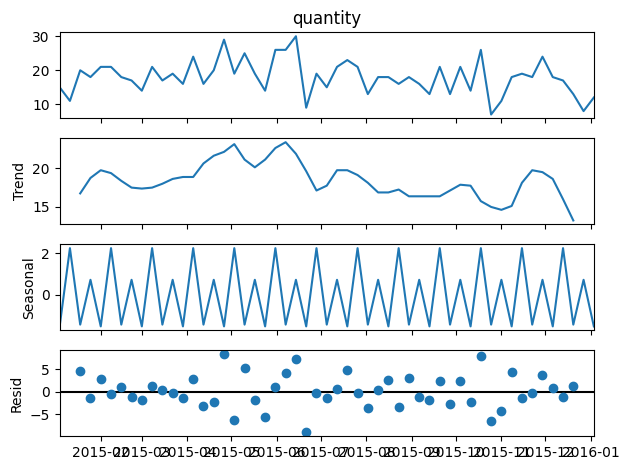

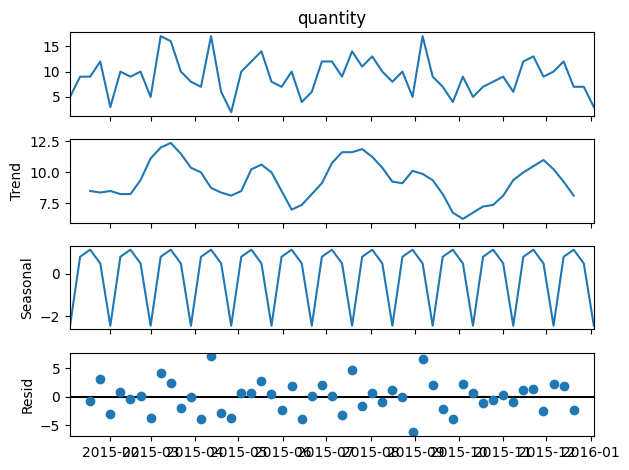

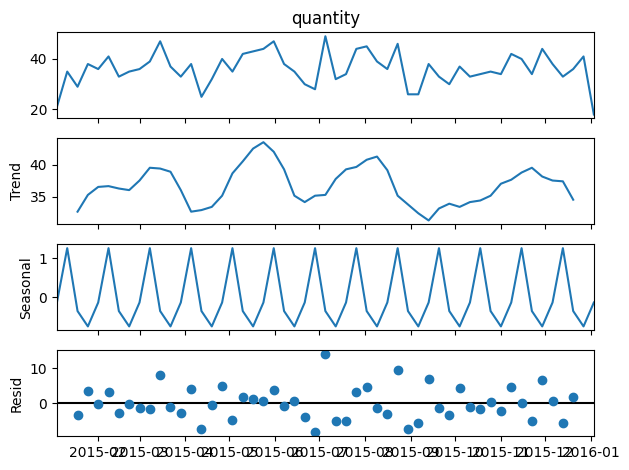

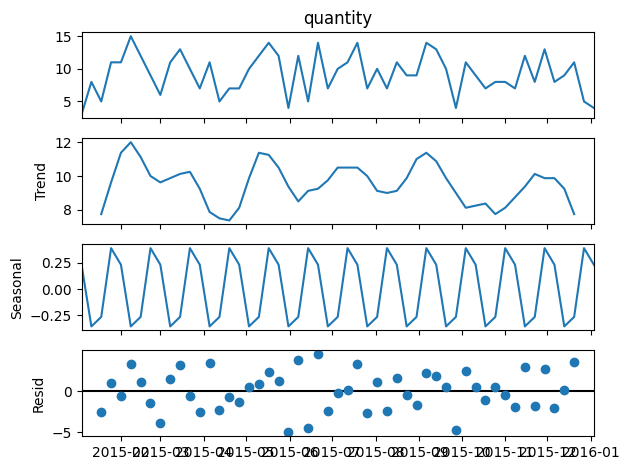

...

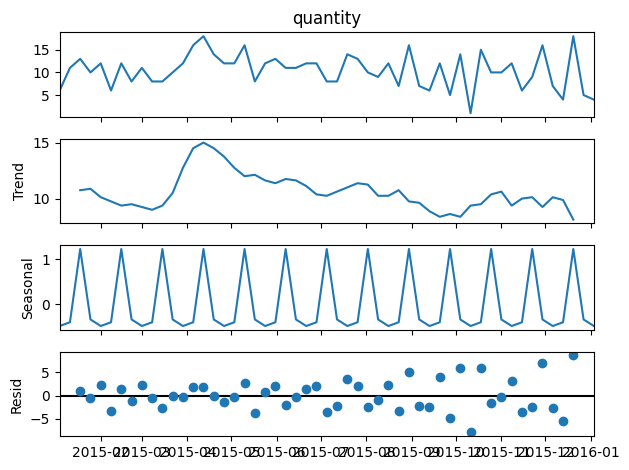

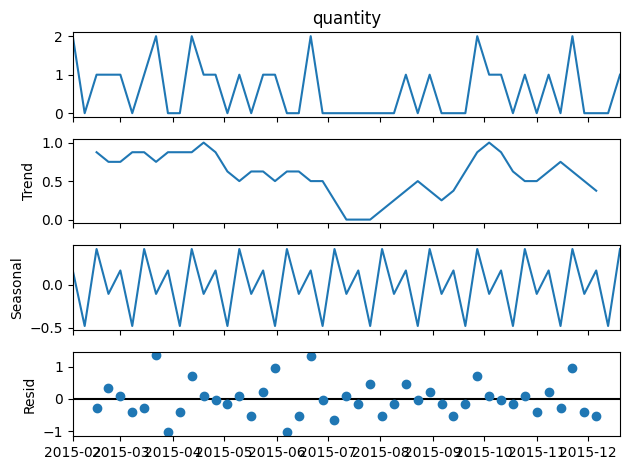

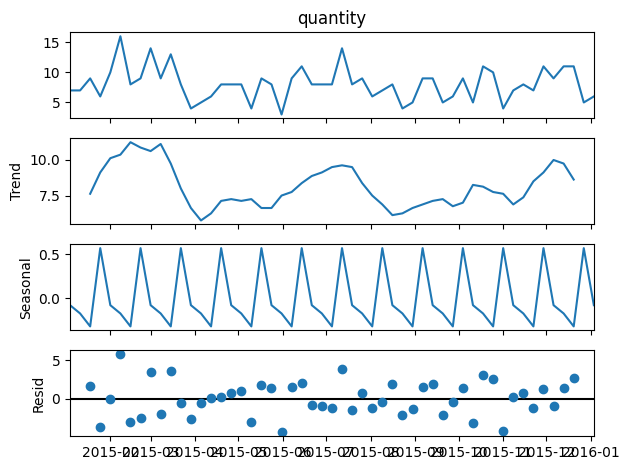

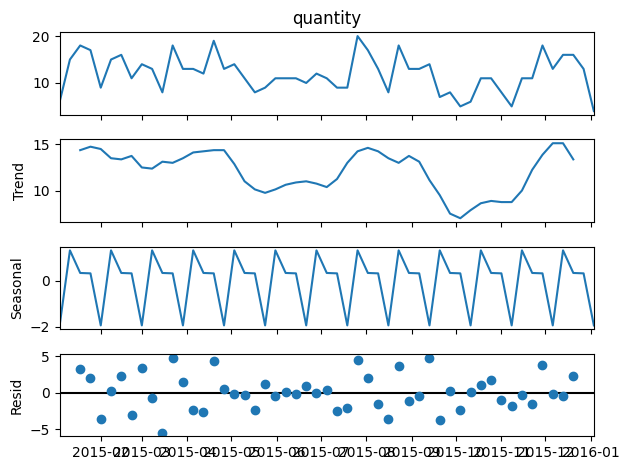

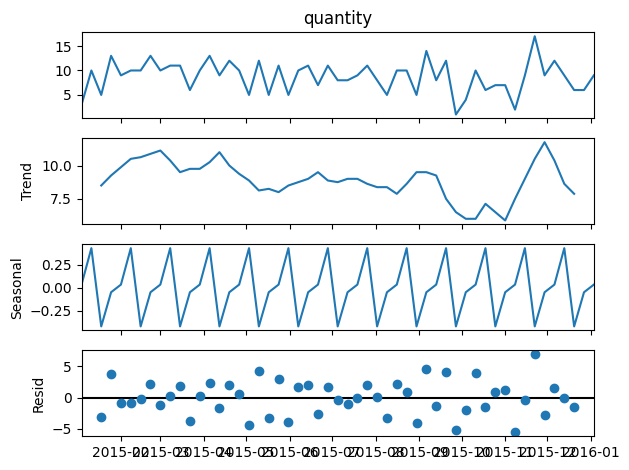

In [33]:
# Seasonal_decomposition of all pizza sales

for pizza in pivoted_df.columns:
    df_decompose = df[df['pizza_name_id'] == pizza]
    df_decompose_weekly = df_decompose['quantity'].resample('W').sum()
    
    decomposition = seasonal_decompose(df_decompose_weekly, model='additive', period=4)
    decomposition.plot()
    plt.show()

In [34]:
# Observations from above decompositions:
# All pizza sales have no trend
# All pizza sales have seasonality
# There is no pattern in residuals of all pizza sales which is 'Random Noise'

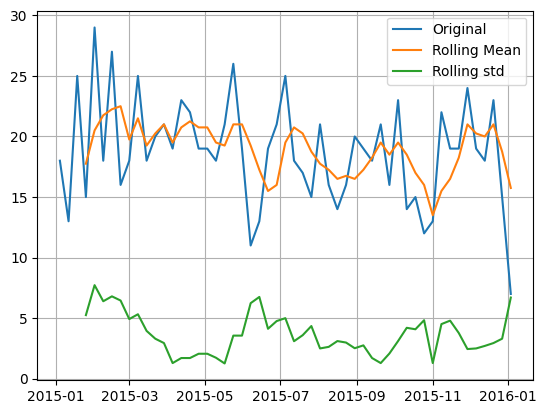

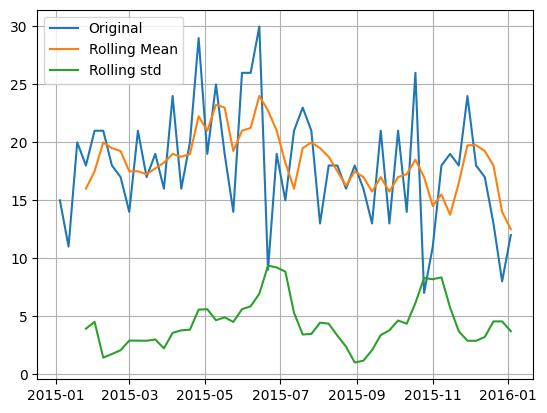

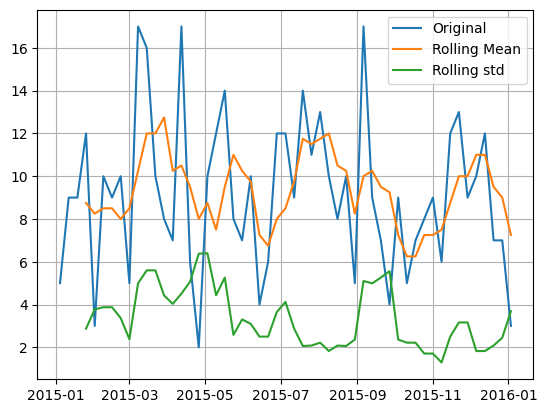

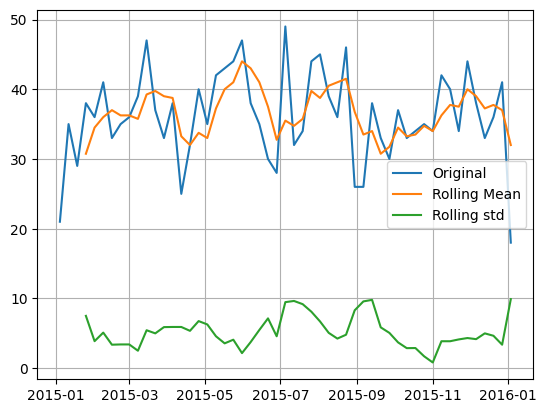

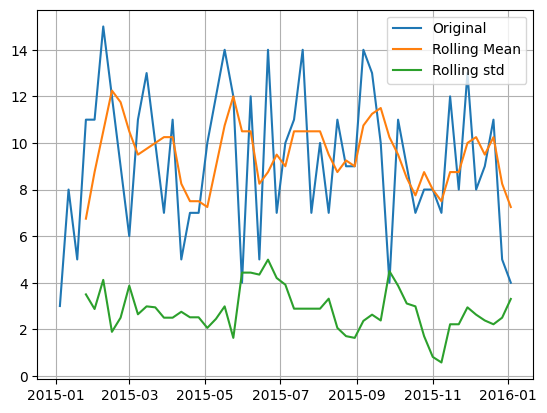

...

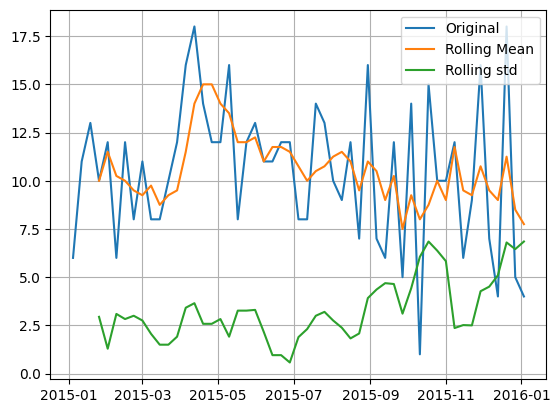

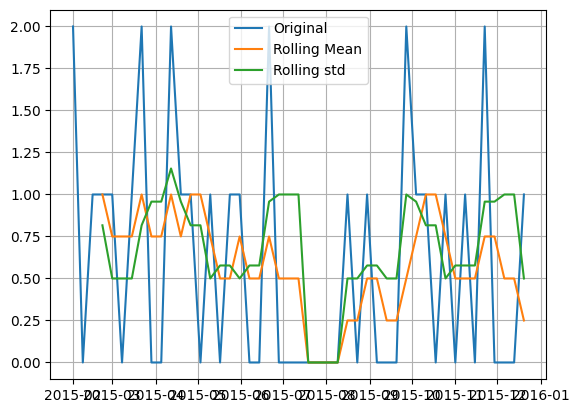

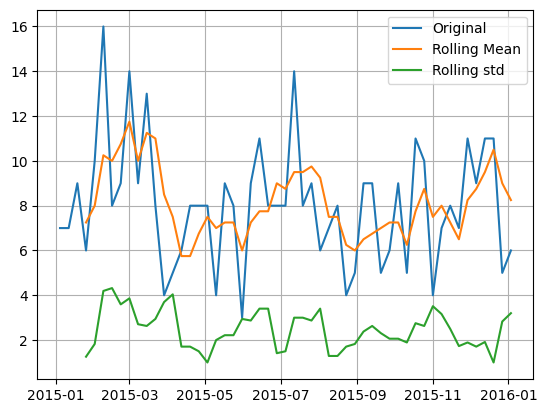

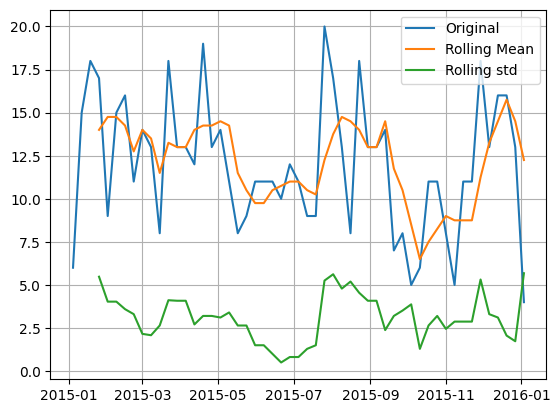

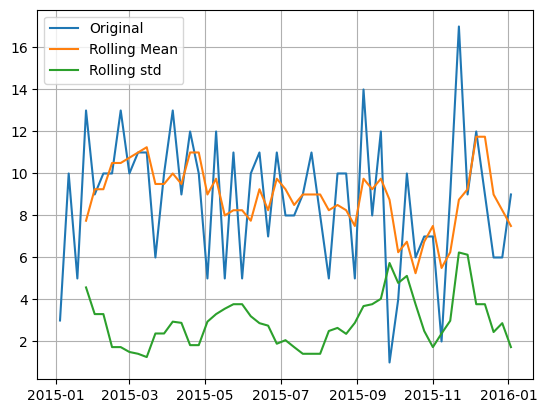

In [35]:
# Plotting 'Rolling Mean' and 'Rolling std' for all pizza sales

for pizza in pivoted_df.columns:
    df_decompose = df[df['pizza_name_id'] == pizza]
    df_decompose_weekly = df_decompose['quantity'].resample('W').sum()
    plt.plot(df_decompose_weekly, label='Original')
    plt.plot(df_decompose_weekly.rolling(window=4).mean(), label='Rolling Mean')
    plt.plot(df_decompose_weekly.rolling(window=4).std(), label='Rolling std')
    plt.legend()
    plt.grid(True)
    plt.show()

In [36]:
# Observations from above 'Rolling mean' and 'Rolling Standard deviation':
# Most Rolling means are constant over the time and some have slight up and downs
# Most Rolling standard deviations are constant over the time and some have wave forms

In [37]:
# Checking for Stationarity

from statsmodels.tsa.stattools import adfuller, kpss

In [38]:
# Applying 'Augumented Dickey-Fuller test' on all pizzas

for pizza in pivoted_df.columns:
    df_decompose = df[df['pizza_name_id'] == pizza]
    df_decompose_weekly = df_decompose['quantity'].resample('W').sum()
    adf_result = adfuller(df_decompose_weekly)
    print(f'ADF Statistic: {adf_result[0]}')
    print(f'p-value: {adf_result[1]}')
    if adf_result[1] < 0.05:
        print(f'The Sales of {pizza} STATIONARY')
    else:
        print(f'The Sales of {pizza} NON-STATIONARY')
    print('_'*50)

ADF Statistic: -4.056410248468355
p-value: 0.0011422936511391681
The Sales of bbq_ckn_l STATIONARY
__________________________________________________
ADF Statistic: -6.694969289642186
p-value: 4.021059501215262e-09
The Sales of bbq_ckn_m STATIONARY
__________________________________________________
ADF Statistic: -6.76236897934279
p-value: 2.771388701365382e-09
The Sales of bbq_ckn_s STATIONARY
__________________________________________________
ADF Statistic: -3.5658006106805598
p-value: 0.006449530315670232
The Sales of big_meat_s STATIONARY
__________________________________________________
ADF Statistic: -7.267858556865814
p-value: 1.6172394601269942e-10
The Sales of brie_carre_s STATIONARY
__________________________________________________
ADF Statistic: -3.804293197007321
p-value: 0.0028636941414384004
The Sales of calabrese_l STATIONARY
__________________________________________________
ADF Statistic: -7.626536810847364
p-value: 2.0615612943902423e-11
The Sales of calabrese_m STA

In [39]:
# By observing ADF test, classic_dlx_m, green_garden_m, the_greek_s sales are not stationary

In [40]:
# Applying 'KPSS(Kwiatkowski-Phillips-Schmidt-Shin) test' on all pizzas

for pizza in pivoted_df.columns:
    df_decompose = df[df['pizza_name_id'] == pizza]
    df_decompose_weekly = df_decompose['quantity'].resample('W').sum()
    statistic, p_value, lags, critical_values = kpss(df_decompose_weekly, regression='c', nlags='auto')
    print(f"KPSS Statistic: {statistic}")
    print(f"P-value: {p_value}")
    if p_value > 0.05:
        print(f'The Sales of {pizza} STATIONARY')
    else:
        print(f'The Sales of {pizza} NON-STATIONARY')
    print('_'*50)

KPSS Statistic: 0.4321812412244989
P-value: 0.06328394774806081
The Sales of bbq_ckn_l STATIONARY
__________________________________________________
KPSS Statistic: 0.3742594754236253
P-value: 0.08825022611050633
The Sales of bbq_ckn_m STATIONARY
__________________________________________________
KPSS Statistic: 0.10072769422675777
P-value: 0.1
The Sales of bbq_ckn_s STATIONARY
__________________________________________________
KPSS Statistic: 0.10053540158837251
P-value: 0.1
The Sales of big_meat_s STATIONARY
__________________________________________________
KPSS Statistic: 0.08973486967722318
P-value: 0.1
The Sales of brie_carre_s STATIONARY
__________________________________________________
KPSS Statistic: 0.06345787015720582
P-value: 0.1
The Sales of calabrese_l STATIONARY
__________________________________________________
KPSS Statistic: 0.07990843374117088
P-value: 0.1
The Sales of calabrese_m STATIONARY
__________________________________________________
KPSS Statistic: 0.122385

In [41]:
# By observing KPSS test results, five_cheese_l, spinach_fet_s sales are not stationary

In [42]:
# Applying Different Models

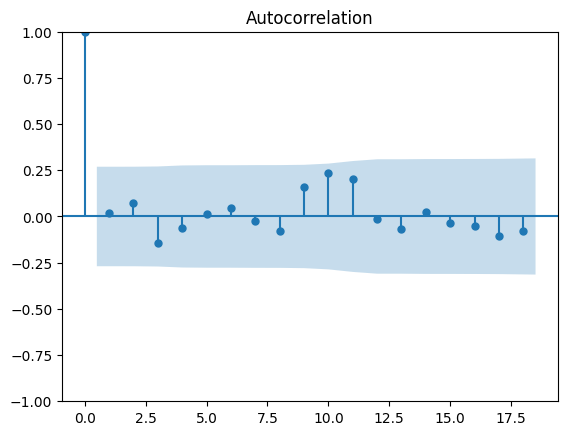

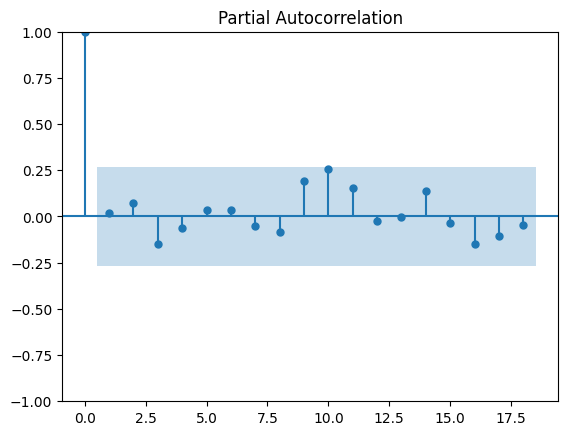

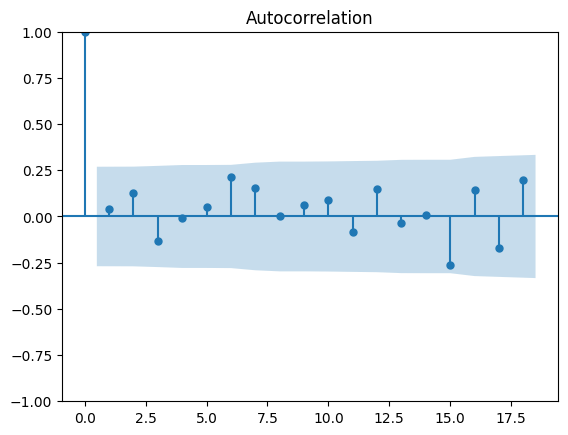

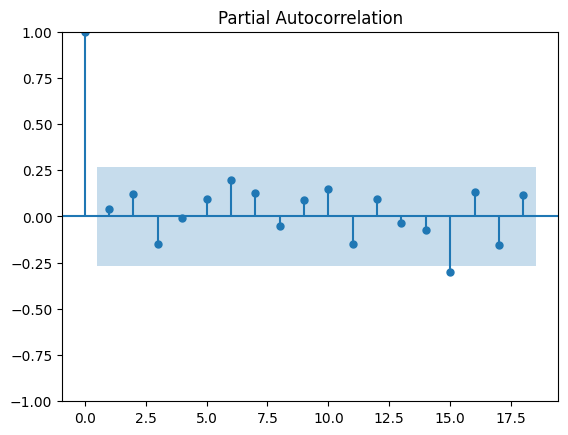

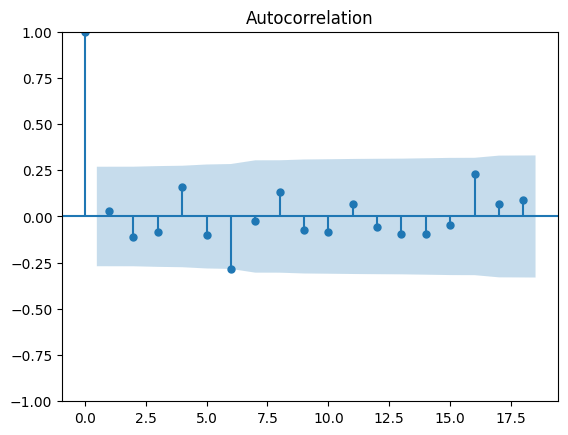

...

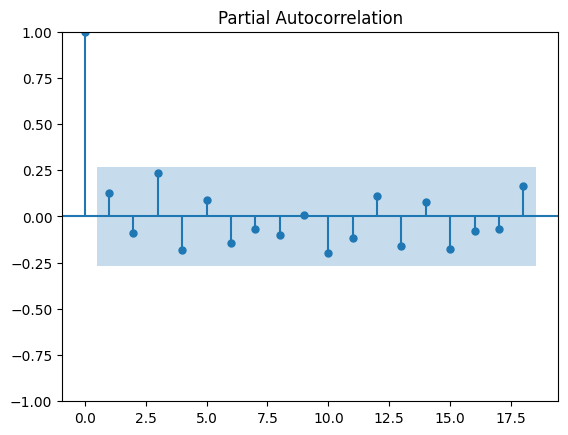

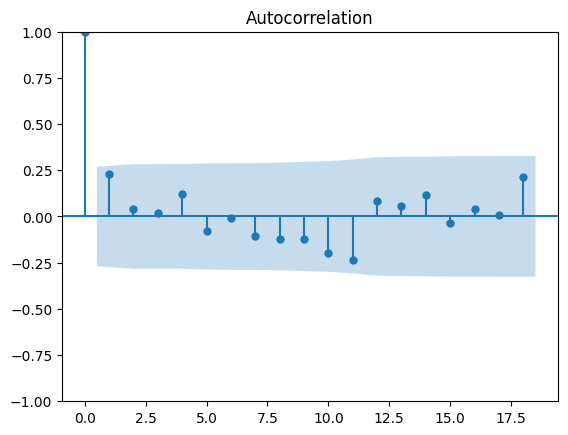

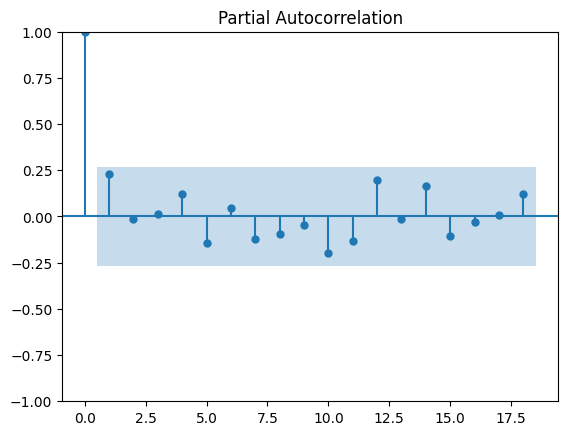

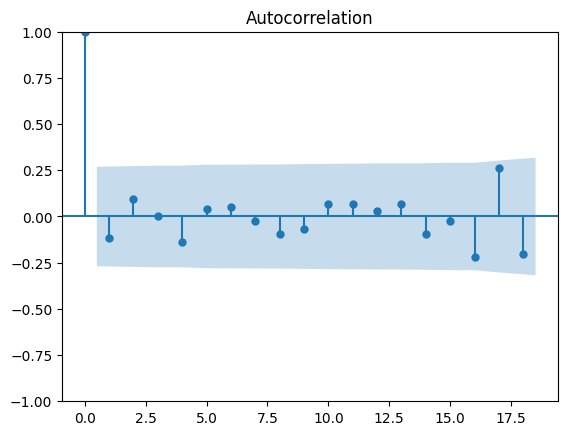

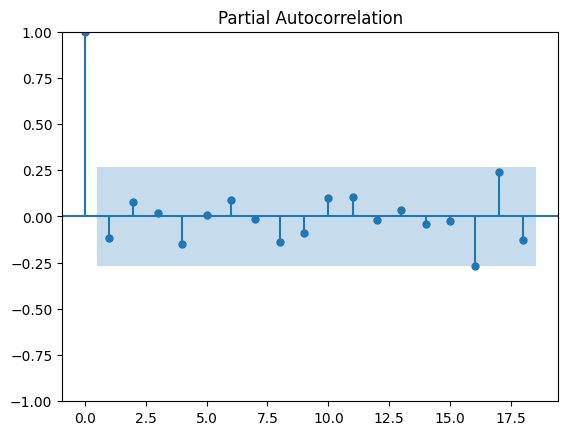

In [43]:
# Plotting ACF and PACF plots for all pizzas

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

for pizza in pivoted_df.columns:
    df_decompose = df[df['pizza_name_id'] == pizza]
    df_decompose_weekly = df_decompose['quantity'].resample('W').sum()
    
    plot_acf(df_decompose_weekly)
    plt.show()

    plot_pacf(df_decompose_weekly)
    plt.show()

In [44]:
# By observing above ACF and PACF plots, the p and q components are 1 lag each

In [45]:
# ARIMA MODEL

In [46]:
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_absolute_percentage_error, mean_absolute_error

for pizza in pivoted_df.columns:
    df_model = df[df['pizza_name_id'] == pizza]
    df_model_weekly = df_model['quantity'].resample('W').sum()

    # Splitting the data into training and testing dataset
    train_size = int(len(df_model_weekly) * 0.8)
    train, test = df_model_weekly.iloc[:train_size], df_model_weekly.iloc[train_size:]

    # Checking Stationarity of the data
    if adfuller(train)[1] > 0.05:
        train = train.diff().dropna()
        order = (1, 1, 1)
    else:
        order = (1, 0, 1)
        
    ARIMA_model = ARIMA(train, order=order)
    ARIMA_model_fit = ARIMA_model.fit()
    ARIMA_forecast = ARIMA_model_fit.forecast(steps=len(test))
    
    ARIMA_mape = mean_absolute_percentage_error(test, ARIMA_forecast)
    ARIMA_mae = mean_absolute_error(test, ARIMA_forecast)
    print(f"MAE and MAPE FOR {pizza}: {ARIMA_mae:.4f} and {ARIMA_mape:.4f}")

MAE and MAPE FOR bbq_ckn_l: 3.8588 and 0.3299
MAE and MAPE FOR bbq_ckn_m: 4.6813 and 0.4671
MAE and MAPE FOR bbq_ckn_s: 2.6894 and 0.4537
MAE and MAPE FOR big_meat_s: 4.7177 and 0.1699
MAE and MAPE FOR brie_carre_s: 2.3800 and 0.3637
MAE and MAPE FOR calabrese_l: 1.6475 and 0.2547
MAE and MAPE FOR calabrese_m: 2.3600 and 0.5639
MAE and MAPE FOR calabrese_s: 0.8245 and 0.5287
MAE and MAPE FOR cali_ckn_l: 6.0131 and 0.4224
MAE and MAPE FOR cali_ckn_m: 4.1913 and 0.2879
MAE and MAPE FOR cali_ckn_s: 3.5193 and 0.5293
MAE and MAPE FOR ckn_alfredo_l: 2.0240 and 1405939086574820.2500
MAE and MAPE FOR ckn_alfredo_m: 2.9367 and 0.2700
MAE and MAPE FOR ckn_alfredo_s: 1.0165 and 2344483615370508.5000
MAE and MAPE FOR ckn_pesto_l: 2.3472 and 0.9152
MAE and MAPE FOR ckn_pesto_m: 2.7334 and 0.8958
MAE and MAPE FOR ckn_pesto_s: 1.8493 and 0.4374
MAE and MAPE FOR classic_dlx_l: 1.7327 and 0.1874
MAE and MAPE FOR classic_dlx_m: 21.9197 and 0.9901
MAE and MAPE FOR classic_dlx_s: 3.2699 and 0.2676
MAE an

In [47]:
# SARIMA MODEL

In [48]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

for pizza in pivoted_df.columns:
    df_model = df[df['pizza_name_id'] == pizza]
    df_model_weekly = df_model['quantity'].resample('W').sum()

    # Splitting the data into training and testing dataset
    train_size = int(len(df_model_weekly) * 0.8)
    train, test = df_model_weekly.iloc[:train_size], df_model_weekly.iloc[train_size:]

    # Checking Stationarity of the data
    if adfuller(train)[1] > 0.05:
        train = train.diff().dropna()
        order = (1, 1, 1)
        seasonal_order = (1, 1, 1, 52)
    else:
        order = (1, 0, 1)
        seasonal_order = (1, 0, 1, 52)
        
    SARIMA_model = SARIMAX(train, order=order, seasonal_order=seasonal_order)
    SARIMA_model_fit = SARIMA_model.fit(disp=False)
    SARIMA_forecast = SARIMA_model_fit.forecast(steps=len(test))
    
    SARIMA_mape = mean_absolute_percentage_error(test, SARIMA_forecast)
    print(f"SARIMA MAPE for {pizza}: {SARIMA_mape:.4f}")


SARIMA MAPE for bbq_ckn_l: 0.3051
SARIMA MAPE for bbq_ckn_m: 0.4209
SARIMA MAPE for bbq_ckn_s: 0.2609
SARIMA MAPE for big_meat_s: 0.1040
SARIMA MAPE for brie_carre_s: 0.2498
SARIMA MAPE for calabrese_l: 0.2911
SARIMA MAPE for calabrese_m: 0.2166
SARIMA MAPE for calabrese_s: 0.4506
SARIMA MAPE for cali_ckn_l: 0.3717
SARIMA MAPE for cali_ckn_m: 0.1802
SARIMA MAPE for cali_ckn_s: 0.5600
SARIMA MAPE for ckn_alfredo_l: 1338256908910719.7500
SARIMA MAPE for ckn_alfredo_m: 0.2078
SARIMA MAPE for ckn_alfredo_s: 2279759971039235.0000
SARIMA MAPE for ckn_pesto_l: 0.7703
SARIMA MAPE for ckn_pesto_m: 0.8009
SARIMA MAPE for ckn_pesto_s: 0.2675
SARIMA MAPE for classic_dlx_l: 0.1589
SARIMA MAPE for classic_dlx_m: 1.0963
SARIMA MAPE for classic_dlx_s: 0.1855
SARIMA MAPE for five_cheese_l: 0.3254
SARIMA MAPE for four_cheese_l: 0.1750
SARIMA MAPE for four_cheese_m: 0.4391
SARIMA MAPE for green_garden_l: 1585549370475053.7500
SARIMA MAPE for green_garden_m: 0.5735
SARIMA MAPE for green_garden_s: 0.3717
S

In [49]:
# PROPHET MODEL

In [50]:
from prophet import Prophet

for pizza in pivoted_df.columns:
    df_prophet = df[df['pizza_name_id'] == pizza].reset_index()
    df_prophet_weekly = df_prophet.groupby([pd.Grouper(key='order_date', freq='W'), 'pizza_name_id']).sum()

    # Splitting the data into training and testing dataset
    train_size = int(len(df_prophet_weekly) * 0.8)
    train, test = df_prophet_weekly.iloc[:train_size], df_prophet_weekly.iloc[train_size:]
    
    train_df = train.reset_index().rename(columns={'order_date': 'ds', 'quantity': 'y'})
    test_df = test.reset_index().rename(columns={'order_date': 'ds', 'quantity': 'y'})

    train_df = train_df.drop(columns='pizza_name_id')
    test_df = test_df.drop(columns='pizza_name_id')
    
    prophet_model = Prophet(weekly_seasonality=True, daily_seasonality=False, yearly_seasonality=False)
    prophet_model.fit(train_df)
    
    future = prophet_model.make_future_dataframe(periods=len(test), freq='W')
    forecast = prophet_model.predict(future)
    
    # Extract only forecasted part
    forecast_y = forecast.set_index('ds').loc[test_df['ds'], 'yhat'].values
    mape_prophet = mean_absolute_percentage_error(test, forecast_y)
    print(f"Prophet MAPE: {mape_prophet:.4f}")


17:28:21 - cmdstanpy - INFO - Chain [1] start processing
17:28:21 - cmdstanpy - INFO - Chain [1] done processing
17:28:22 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.3101


17:28:22 - cmdstanpy - INFO - Chain [1] done processing
17:28:22 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.4802


17:28:22 - cmdstanpy - INFO - Chain [1] done processing
17:28:22 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.3665


17:28:23 - cmdstanpy - INFO - Chain [1] done processing
17:28:23 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.1718


17:28:23 - cmdstanpy - INFO - Chain [1] done processing
17:28:23 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.4078


17:28:23 - cmdstanpy - INFO - Chain [1] done processing
17:28:24 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.2598


17:28:24 - cmdstanpy - INFO - Chain [1] done processing
17:28:24 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.5823


17:28:24 - cmdstanpy - INFO - Chain [1] done processing
17:28:24 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.4859


17:28:25 - cmdstanpy - INFO - Chain [1] done processing
17:28:25 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.4151


17:28:25 - cmdstanpy - INFO - Chain [1] done processing
17:28:25 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.2589


17:28:25 - cmdstanpy - INFO - Chain [1] done processing
17:28:25 - cmdstanpy - INFO - Chain [1] start processing


Prophet MAPE: 0.5760


17:28:26 - cmdstanpy - INFO - Chain [1] done processing


KeyError: "[Timestamp('2016-01-03 00:00:00')] not in index"

In [ ]:
# Forecasting the sales of pizzas for next week

In [51]:
from prophet import Prophet

df_weekly = df.reset_index().groupby([pd.Grouper(key='order_date', freq='W'), 'pizza_name_id']).sum().reset_index()

def forecast_pizza_sales(pizza_name, weeks_ahead=1):
    df_pizza = df_weekly[df_weekly['pizza_name_id'] == pizza_name]
    df_pizza = df_pizza.rename(columns={'order_date': 'ds', 'quantity': 'y'})[['ds', 'y']]
    
    model = Prophet()
    model.fit(df_pizza)

    # Future dataframe
    future = model.make_future_dataframe(periods=weeks_ahead, freq='W')
    forecast = model.predict(future)

    return forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(weeks_ahead)

In [52]:
all_pizzas = df_weekly['pizza_name_id'].unique()
forecasts = {}

for pizza in all_pizzas:
    forecast_df = forecast_pizza_sales(pizza, weeks_ahead=1)
    predicted_qty = forecast_df.iloc[-1]['yhat']
    forecasts[pizza] = max(0, int(round(predicted_qty))) 

print(forecasts)

17:29:06 - cmdstanpy - INFO - Chain [1] start processing
17:29:06 - cmdstanpy - INFO - Chain [1] done processing
17:29:06 - cmdstanpy - INFO - Chain [1] start processing
17:29:06 - cmdstanpy - INFO - Chain [1] done processing
17:29:07 - cmdstanpy - INFO - Chain [1] start processing
17:29:07 - cmdstanpy - INFO - Chain [1] done processing
17:29:07 - cmdstanpy - INFO - Chain [1] start processing
17:29:07 - cmdstanpy - INFO - Chain [1] done processing
17:29:07 - cmdstanpy - INFO - Chain [1] start processing
17:29:08 - cmdstanpy - INFO - Chain [1] done processing
17:29:08 - cmdstanpy - INFO - Chain [1] start processing
17:29:08 - cmdstanpy - INFO - Chain [1] done processing
17:29:08 - cmdstanpy - INFO - Chain [1] start processing
17:29:08 - cmdstanpy - INFO - Chain [1] done processing
17:29:08 - cmdstanpy - INFO - Chain [1] start processing
17:29:09 - cmdstanpy - INFO - Chain [1] done processing
17:29:09 - cmdstanpy - INFO - Chain [1] start processing
17:29:09 - cmdstanpy - INFO - Chain [1]

{'bbq_ckn_l': 17, 'bbq_ckn_m': 16, 'bbq_ckn_s': 9, 'big_meat_s': 36, 'brie_carre_s': 9, 'calabrese_m': 10, 'calabrese_s': 2, 'cali_ckn_l': 17, 'cali_ckn_m': 16, 'cali_ckn_s': 10, 'ckn_alfredo_l': 4, 'ckn_alfredo_m': 13, 'ckn_alfredo_s': 3, 'ckn_pesto_l': 7, 'ckn_pesto_m': 6, 'ckn_pesto_s': 5, 'classic_dlx_l': 9, 'classic_dlx_m': 24, 'classic_dlx_s': 15, 'five_cheese_l': 23, 'four_cheese_l': 24, 'four_cheese_m': 10, 'green_garden_l': 2, 'green_garden_m': 5, 'green_garden_s': 11, 'hawaiian_l': 18, 'hawaiian_m': 9, 'hawaiian_s': 19, 'ital_cpcllo_l': 14, 'ital_cpcllo_m': 6, 'ital_cpcllo_s': 5, 'ital_supr_l': 14, 'ital_supr_m': 16, 'ital_supr_s': 4, 'ital_veggie_l': 3, 'ital_veggie_m': 8, 'ital_veggie_s': 5, 'mediterraneo_l': 7, 'mediterraneo_m': 6, 'mediterraneo_s': 6, 'mexicana_l': 16, 'mexicana_m': 9, 'mexicana_s': 4, 'napolitana_l': 10, 'napolitana_m': 8, 'napolitana_s': 8, 'pep_msh_pep_l': 7, 'pep_msh_pep_m': 7, 'pep_msh_pep_s': 10, 'pepperoni_l': 12, 'pepperoni_m': 17, 'pepperoni_s': 

In [53]:
# Calculating Ingredients for one week

In [54]:
ingredient_map = {}

for _, row in df_ingredients.iterrows():
    pizza_id = row['pizza_name_id']
    ingredient = row['pizza_ingredients']
    qty = row['Items_Qty_In_Grams']
    
    if pizza_id not in ingredient_map:
        ingredient_map[pizza_id] = {}
    
    ingredient_map[pizza_id][ingredient] = qty


In [56]:
# Calculate total ingredients needed
ingredient_totals = {}

for pizza, predicted_qty in forecasts.items():
    ingredients = ingredient_map.get(pizza, {})
    for ingredient, qty_per_pizza in ingredients.items():
        ingredient_totals[ingredient] = ingredient_totals.get(ingredient, 0) + predicted_qty * qty_per_pizza

# Convert to DataFrame
pizza_order_df = pd.DataFrame(ingredient_totals.items(), columns=['Ingredient', 'Required_Quantity_in_gms'])
pizza_order_df

,Ingredient,Required_Quantity_in_gms
0,Barbecued Chicken,1340.0
1,Red Peppers,3335.0
2,Green Peppers,1670.0
3,Tomatoes,10750.0
4,Red Onions,15820.0
...,...,...
59,Onions,690.0
60,Soppressata Salami,1800.0
61,Peperoncini verdi,405.0
62,Thai Sweet Chilli Sauce,1110.0


In [57]:
# pizza_order_df.to_csv('Ingredients_Demand_For_Week.csv')